Был проведен анализ данных:
1) нет обманных изображений (футболок с принтами огня, ярко-красных/оранжевых объектов; тумана/паров/вейпа/выхлопных газов)
2) огонь занимает существенную часть изображения и контрастен
3) у изображений сильно отличается разрешение
4) всего порядка 1-1.5 тысяч изображений, все в формате jpg

В качестве бейзлайна решено использовать YOLO12, тренируемую на задачу детекции.

In [1]:
import os
import json
import shutil
from time import time

import numpy as np
import pandas as pd
from matplotlib import pyplot as plt
import seaborn as sns
from IPython.display import Image

import cv2
from ultralytics import YOLO

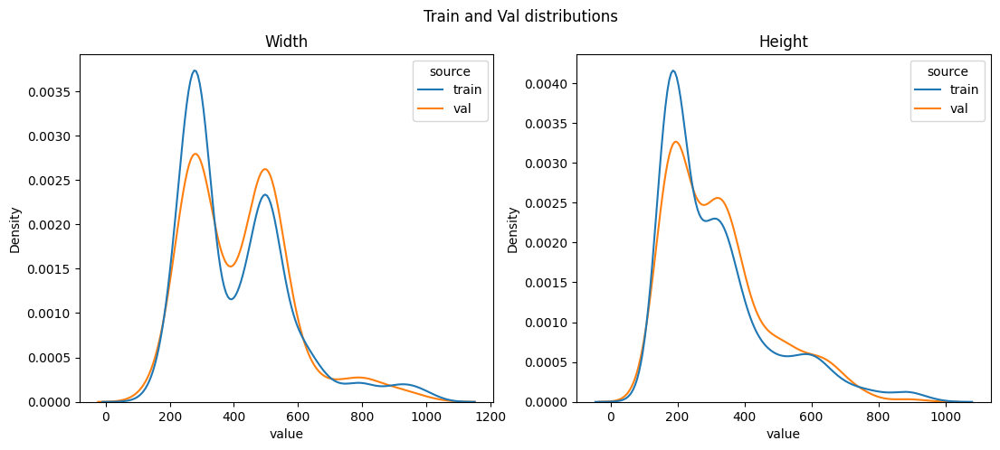

In [120]:
train_meta = r'datasets\475_fire_train\annotations\instances_default.json'
val_meta = r'datasets\474_fire_val\annotations\instances_default.json'

def show_wh_kdes(train_meta, val_meta, quantile_thresh = 1.0):
    dfs = []
    for path, source_name in [(train_meta, 'train'), (val_meta, 'val')]:
        with open(path, 'r') as j:
            meta = json.load(j)
        widths = [meta['images'][id]['width'] for id in range(len(meta['images']))]
        heights = [meta['images'][id]['height'] for id in range(len(meta['images']))]

        dfs.append(pd.DataFrame({'width': widths, 'height': heights, 'source': [source_name] * len(widths)}))

    df = pd.concat(dfs)
    df = df.loc[(df['width'] < df['width'].quantile(quantile_thresh)) & (df['height'] < df['height'].quantile(quantile_thresh)), :]
    df_melted = pd.melt(df, id_vars=['source'], var_name='variable', value_name='value')
    fig, axes = plt.subplots(1, 2, figsize=(13, 5))
    fig.suptitle('Train and Val distributions')

    for i, var_name in enumerate(['width', 'height']):
        sns.kdeplot(df_melted[df_melted['variable'] == var_name], x='value', hue='source', ax=axes[i], common_norm=False).set_title(var_name.capitalize())

quantile_thresh = 0.85
show_wh_kdes(train_meta, val_meta, quantile_thresh)

Выводы:
1. вероятно, train и val данные пришли из одного распределения (судя по распределениям высот и широт)
2. вероятно, использовать разрешение выше 640x640 нецелесообразно (т.к. мало изображений с оригинальным разрешением выше 640x640)

In [121]:
for path in [train_meta, val_meta]:
    with open(path, 'r') as j:
        meta = json.load(j)
        print([meta['categories'][i]['name'] for i in range(0, len(meta['categories']))])

['motorcycle', 'bicycle', 'wheelchair', 'smoke', 'fire', 'scooter', 'person']
['motorcycle', 'bicycle', 'wheelchair', 'smoke', 'fire', 'scooter', 'person']


In [122]:
def save_filtered_annotations(src, dst):
    with open(src, 'r') as j:
        meta = json.load(j)
        meta['categories'] = list(
            filter(lambda cat: cat['name'] == 'smoke' or cat['name'] == 'fire', meta['categories']))
        cat_ids = [cat['id'] for cat in meta['categories']]
        meta['annotations'] = list(filter(lambda a: a['category_id'] in cat_ids, meta['annotations']))

        for cat in meta['categories']:
            cat['id'] = cat_ids.index(cat['id'])
        for a in meta['annotations']:
            a['category_id'] = cat_ids.index(a['category_id'])

        with open(dst, 'w') as f:
            json.dump(meta, f)

        print(meta['categories'])

for src in [train_meta, val_meta]:
    dst = src.replace('instances_default.json', 'instances_selected.json')
    save_filtered_annotations(src, dst)

[{'id': 0, 'name': 'smoke', 'supercategory': ''}, {'id': 1, 'name': 'fire', 'supercategory': ''}]
[{'id': 0, 'name': 'smoke', 'supercategory': ''}, {'id': 1, 'name': 'fire', 'supercategory': ''}]


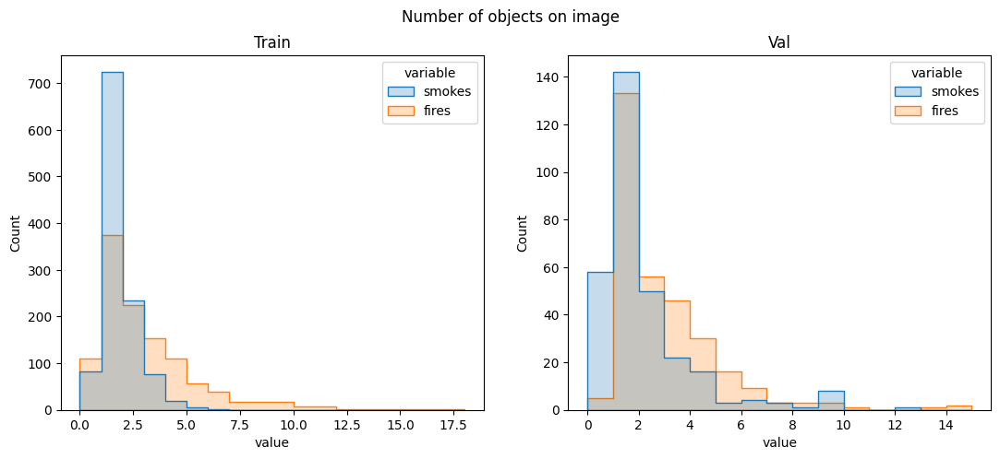

In [123]:
def show_label_dist(train_meta, val_meta):
    fig, axes = plt.subplots(1, 2, figsize=(13, 5))
    fig.suptitle('Number of objects on image')

    for i, path, source in [(0, train_meta, 'Train'), (1, val_meta, 'Val')]:
        with open(path, 'r') as j:
            meta = json.load(j)
            image_ids = [annot['image_id'] for annot in meta['annotations']]
            category_ids = [annot['category_id'] for annot in meta['annotations']]
            df = pd.DataFrame({'image_id': image_ids, 'category_id': category_ids})
            df = df.groupby('image_id')['category_id'].agg(
                smokes=lambda x: (x == 0).sum(),
                fires=lambda x: (x == 1).sum(),
            ).reset_index()
            df_melted = pd.melt(df, value_vars=['smokes', 'fires'])
            sns.histplot(df_melted, x='value', hue='variable',  binwidth=1, element='step', ax=axes[i]).set_title(source)

train_meta = r'datasets\475_fire_train\annotations\instances_selected.json'
val_meta = r'datasets\474_fire_val\annotations\instances_selected.json'
show_label_dist(train_meta, val_meta)

Выводы:
1. не обнаружен сильный дисбаланс классов (сопоставимые площади smokes и fires), но распределение числа объектов дыма более узкое
2. распределения на train/val визуально подобны
3. наиболее часто на изображении присутствует 2 объекта-огня и 2 объекта-дыма

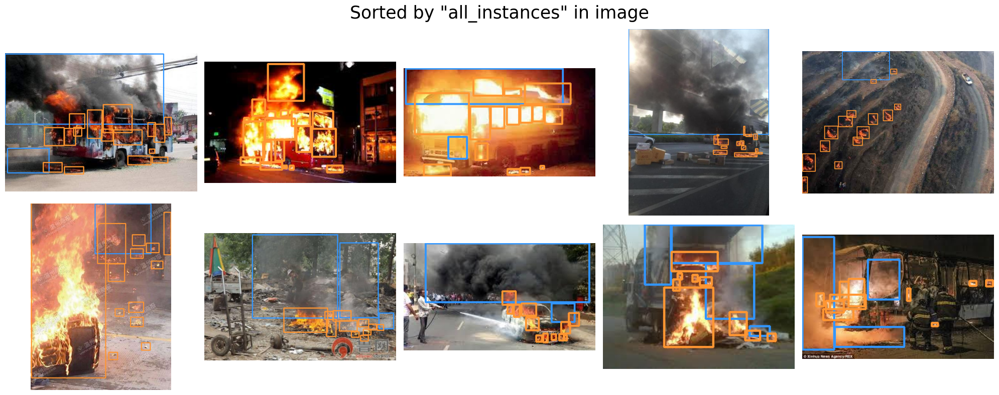

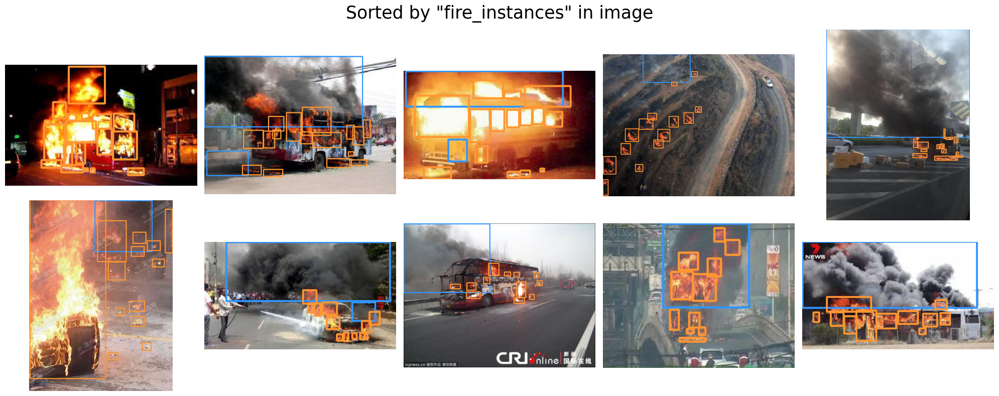

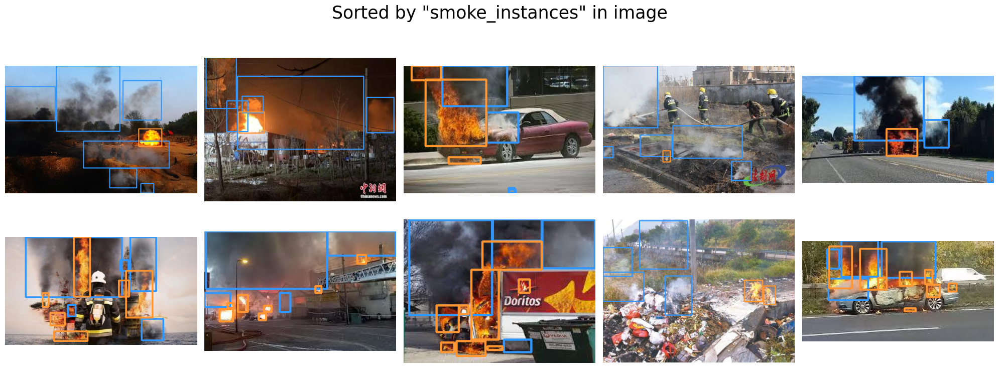

In [51]:
def visualize_annotations(root, meta_path, sort_column = 'total', ascending = False, nrows=2, ncols=5, scale=4, suptitle = None):
    with open(meta_path, 'r') as j:
        meta = json.load(j)
        image_ids = [annot['image_id'] for annot in meta['annotations']]
        category_ids = [annot['category_id'] for annot in meta['annotations']]
        df = pd.DataFrame({'image_id': image_ids, 'category_id': category_ids})
        df = df.groupby('image_id')['category_id'].agg(
            smoke_instances=lambda x: (x == 0).sum(),
            fire_instances=lambda x: (x == 1).sum(),
            all_instances='count'
        ).reset_index()

        img_paths = {image_meta['id']: image_meta['file_name'] for image_meta in meta['images']}
        bbox_dict = {annot['image_id']: {'smoke_instances': [], 'fire_instances': []} for annot in meta['annotations']}
        for annot in meta['annotations']:
            if annot['category_id'] == 0:
                bbox_dict[annot['image_id']]['smoke_instances'].append(annot['bbox'])
            elif annot['category_id'] == 1:
                bbox_dict[annot['image_id']]['fire_instances'].append(annot['bbox'])
        
        fig, axes = plt.subplots(nrows, ncols, figsize=(ncols * scale, nrows * scale))
        fig.suptitle(suptitle, fontsize=25)
        for i, id in enumerate(df.sort_values(sort_column, ascending=ascending)['image_id'][:nrows*ncols]):
            img = cv2.imread(os.path.join(root, img_paths[id]))
            for label, color in [('smoke_instances', (255, 150, 50)), ('fire_instances', (50, 150, 255))]:
                for bbox in bbox_dict[id][label]:
                    x, y, w, h = [int(el) for el in bbox]
                    cv2.rectangle(img, (x, y), (x+w,y+h), color, 2)
            axes[i // ncols, i % ncols].imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
            axes[i // ncols, i % ncols].axis('off')
        fig.tight_layout()
        plt.show()

train_meta = r'datasets\475_fire_train\annotations\instances_selected.json'
val_meta = r'datasets\474_fire_val\annotations\instances_selected.json'
train_root = r'datasets\475_fire_train\images'
val_root = r'datasets\474_fire_val\images'

for sort_column in ['all_instances', 'fire_instances', 'smoke_instances']:
    visualize_annotations(train_root, train_meta, sort_column, nrows=2, ncols=5, scale=4, suptitle=f'Sorted by "{sort_column}" in image')

Выводы:
1. в разметке много объектов, прилегающих/пересекающихся друг с другом
2. сами рамки достаточно точные и не трубуют систематической корректировки/дополнения/удаления
3. присутствуют рамки очень малого размера, которые, вероятно, не будут детектироваться

Решение:
    Вероятно, система детектирует огонь/дым для демонстрации оператору, а значит разделение отдельных языков/элементов пламени не имеет смысла
    - главное, чтобы можно было определить источники пламени.
    Поэтому для бейзлайна решено объединить соприкасающиеся/пересекающиеся рамки (далее при необходимости можно объединять и соседние рамки)

In [52]:
def merge_overlapping_bboxes(bboxes, x_thresh = 0, y_thresh = 0):
    def are_neighbours(a, b, thresh = 0):
        left, right = (a, b) if a[0] < b[0] else (b, a)
        upper, lower = (a, b) if a[1] < b[1] else (b, a)

        if right[0] - (left[0] + left[2]) < x_thresh and lower[1] - (upper[1] + upper[3]) < y_thresh:
            return True

        return False

    def get_merged_box(a):
        x1 = min([bbox[0] for bbox in a])
        x2 = max([bbox[0] + bbox[2] for bbox in a])
        y1 = min([bbox[1] for bbox in a])
        y2 = max([bbox[1] + bbox[3] for bbox in a])

        return (x1, y1, x2 - x1, y2 - y1)

    unprocessed = bboxes[:]
    processed = []
    while len(unprocessed) > 0:
        neighbours = [unprocessed[0]]
        for i in range(len(unprocessed) - 1, 0, -1):
            if are_neighbours(unprocessed[0], unprocessed[i], thresh):
                neighbours.append(unprocessed[i])
                del unprocessed[i]

        if len(neighbours) > 1:
            merged = get_merged_box(neighbours)
            unprocessed.append(merged)
        else:
            processed.append(unprocessed[0])
        del unprocessed[0]

    return processed

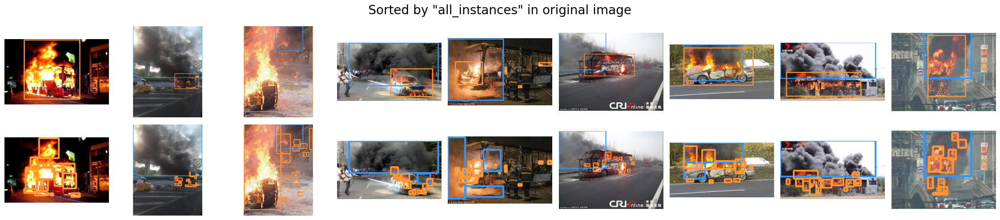

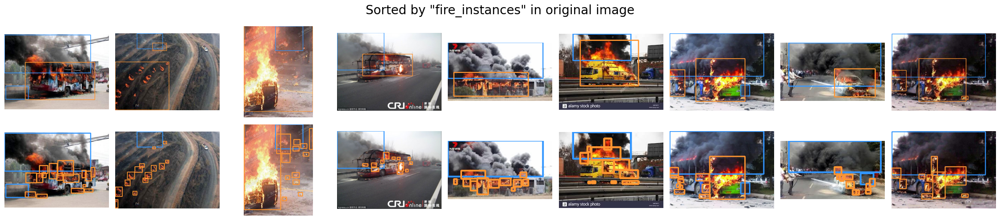

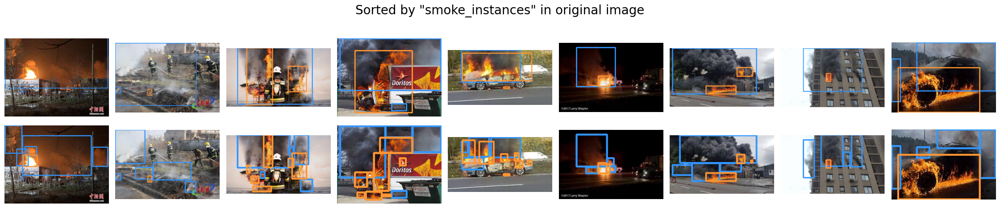

In [58]:
def visualize_processing(root, meta_path, thresh = 0, sort_column='total', ncols=5, scale=3, ascending=False, suptitle = None):
    with open(meta_path, 'r') as j:
        meta = json.load(j)
        image_ids = [annot['image_id'] for annot in meta['annotations']]
        category_ids = [annot['category_id'] for annot in meta['annotations']]
        df = pd.DataFrame({'image_id': image_ids, 'category_id': category_ids})
        df = df.groupby('image_id')['category_id'].agg(
            smoke_instances=lambda x: (x == 0).sum(),
            fire_instances=lambda x: (x == 1).sum(),
            all_instances='count'
        ).reset_index()

        img_paths = {image_meta['id']: image_meta['file_name'] for image_meta in meta['images']}
        bbox_dict = {annot['image_id']: {'smoke_instances': [], 'fire_instances': []} for annot in meta['annotations']}
        for annot in meta['annotations']:
            if annot['category_id'] == 0:
                bbox_dict[annot['image_id']]['smoke_instances'].append(annot['bbox'])
            elif annot['category_id'] == 1:
                bbox_dict[annot['image_id']]['fire_instances'].append(annot['bbox'])
        
        fig, axes = plt.subplots(2, ncols, figsize=(ncols * scale, 2 * scale))
        fig.suptitle(suptitle, fontsize=20)
        for i, id in enumerate(df.sort_values(sort_column, ascending=ascending)['image_id'][:ncols*2]):
            img = cv2.imread(os.path.join(root, img_paths[id]))
            proc_img = img.copy()
            for label, color in [('smoke_instances', (255, 150, 50)), ('fire_instances', (50, 150, 255))]:
                for bbox in bbox_dict[id][label]:
                    x, y, w, h = [int(el) for el in bbox]
                    cv2.rectangle(img, (x, y), (x+w,y+h), color, 3)
            axes[1, i // 2].imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
            axes[1, i // 2].axis('off')
            
            x_thresh = thresh * img.shape[1]
            y_thresh = thresh * img.shape[0]
            bbox_dict[id] = {label: merge_overlapping_bboxes(bbox_dict[id][label], x_thresh=x_thresh, y_thresh=y_thresh) for label in 'smoke_instances fire_instances'.split()}
            for label, color in [('smoke_instances', (255, 150, 50)), ('fire_instances', (50, 150, 255))]:
                for bbox in bbox_dict[id][label]:
                    x, y, w, h = [int(el) for el in bbox]
                    cv2.rectangle(proc_img, (x, y), (x+w,y+h), color, 2)
            axes[0, i // 2].imshow(cv2.cvtColor(proc_img, cv2.COLOR_BGR2RGB))
            axes[0, i // 2].axis('off')
        fig.tight_layout()
        plt.show()

train_meta = r'datasets\475_fire_train\annotations\instances_selected.json'
val_meta = r'datasets\474_fire_val\annotations\instances_selected.json'
train_root = r'datasets\475_fire_train\images'
val_root = r'datasets\474_fire_val\images'
thresh = 0.1
for sort_column in ['all_instances', 'fire_instances', 'smoke_instances']:
    visualize_processing(train_root, train_meta, ncols=9, scale=2.5, thresh=thresh, sort_column=sort_column, ascending=False, suptitle=f'Sorted by "{sort_column}" in original image')

In [222]:
def save_processed_annotations(src, dst, thresh, area_thresh = 0):
    with open(src, 'r') as j:
        meta = json.load(j)

        img_annots = {}
        for annot in meta['annotations']:
            if annot['image_id'] not in img_annots.keys():
                img_annots[annot['image_id']] = [annot]
            else:
                img_annots[annot['image_id']].append(annot)

        new_annots = []
        for image in meta['images']:
            if image['id'] in img_annots.keys():
                bboxes = [annot['bbox'] for annot in img_annots[image['id']]]
                labels = [annot['category_id'] for annot in img_annots[image['id']]]

                smokes = []
                fires = []
                for i, bbox in enumerate(bboxes):
                    if labels[i] == 0:
                        smokes.append(bbox)
                    elif labels[i] == 1:
                        fires.append(bbox)

                x_thresh = thresh * image['width']
                y_thresh = thresh * image['height']

                smokes = merge_overlapping_bboxes(smokes, x_thresh, y_thresh)
                fires = merge_overlapping_bboxes(fires, x_thresh, y_thresh)
                
                labels = [0] * len(smokes) + [1] * len(fires)

                for i, bbox in enumerate(smokes + fires):
                    if bbox[2] * bbox[3] < x_thresh * y_thresh * area_thresh:
                        continue
                    new_annots.append({
                        'image_id': image['id'],
                        'category_id': labels[i],
                        'bbox': bbox,
                    })

        meta['annotations'] = new_annots
        with open(dst, 'w') as f:
            json.dump(meta, f)

train_meta = r'datasets\475_fire_train\annotations\instances_selected.json'
val_meta = r'datasets\474_fire_val\annotations\instances_selected.json'
thresh = 0.1
area_thresh = 0.25
for src in [train_meta, val_meta]:
    dst = src.replace('instances_selected.json', 'instances_processed.json')
    save_processed_annotations(src, dst, thresh, area_thresh)

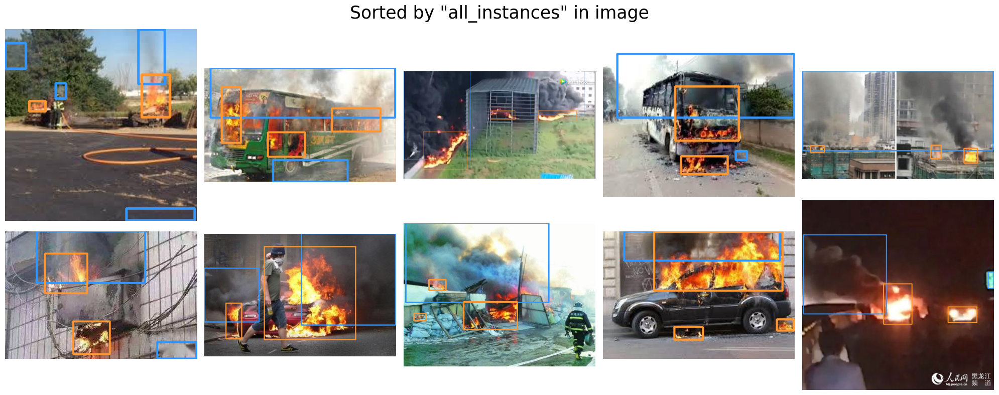

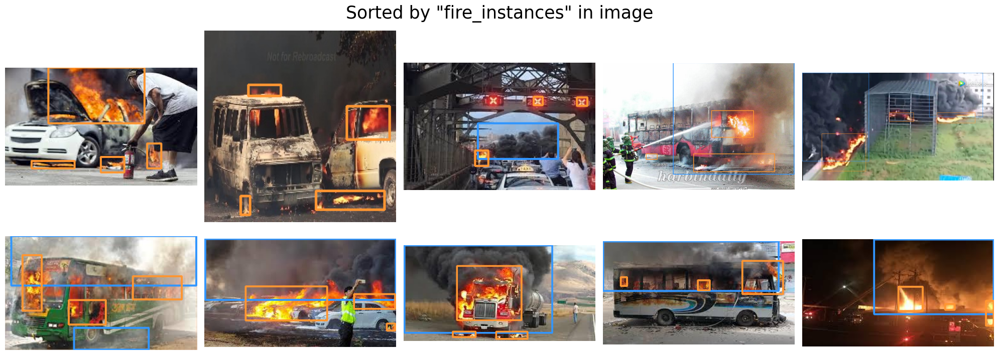

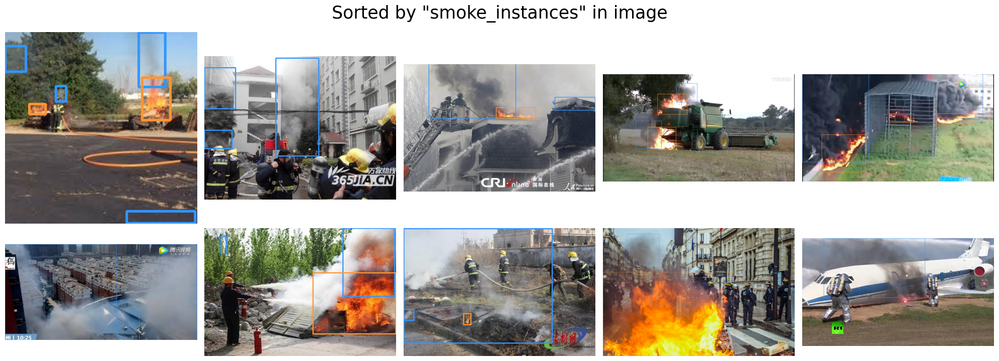

In [59]:
train_meta = r'datasets\475_fire_train\annotations\instances_processed.json'
val_meta = r'datasets\474_fire_val\annotations\instances_processed.json'
train_root = r'datasets\475_fire_train\images'
val_root = r'datasets\474_fire_val\images'

for sort_column in ['all_instances', 'fire_instances', 'smoke_instances']:
    visualize_annotations(train_root, train_meta, sort_column, nrows=2, ncols=5, scale=4, suptitle=f'Sorted by "{sort_column}" in image', ascending=False)

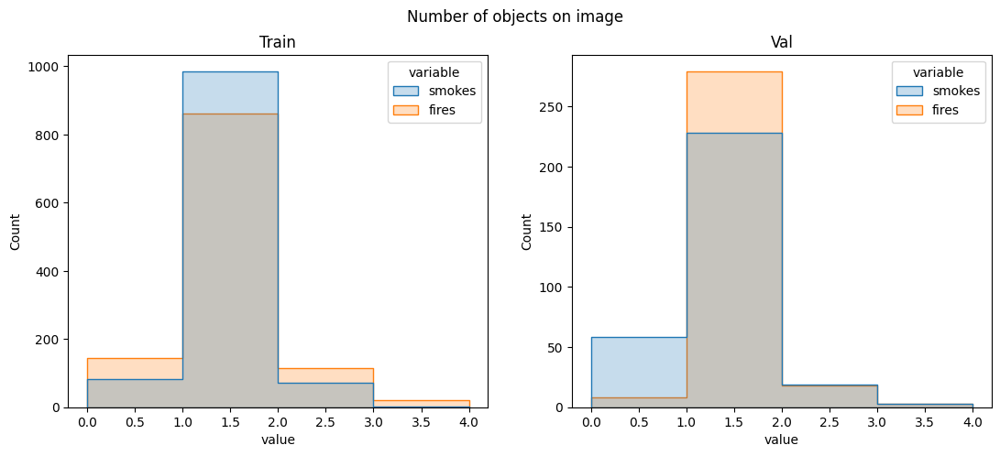

In [224]:
show_label_dist(train_meta, val_meta)

In [225]:
def build_yolo_dataset(train_meta, val_meta, train_img_src, val_img_src, dst):
    def convert_bbox(img_width, img_height, bbox):
        x_tl, y_tl, w, h = bbox

        dw = 1.0 / img_width
        dh = 1.0 / img_height

        x_center = x_tl + w / 2.0
        y_center = y_tl + h / 2.0

        x = x_center * dw
        y = y_center * dh
        w = w * dw
        h = h * dh

        return [x, y, w, h]

    if os.path.exists(dst):
        shutil.rmtree(dst)
    [os.makedirs(os.path.join(dst, sf, mode)) for sf in ['images', 'labels'] for mode in ['train', 'val']]

    for meta_path, img_src in [(train_meta, train_img_src), (val_meta, val_img_src)]:
        with open(meta_path, 'r') as j:
            meta = json.load(j)

            img_annots = {}
            for annot in meta['annotations']:
                if annot['image_id'] not in img_annots.keys():
                    img_annots[annot['image_id']] = [annot]
                else:
                    img_annots[annot['image_id']].append(annot)

            for image in meta['images']:
                width = image["width"]
                height = image["height"]
                name = image["file_name"]
                
                shutil.copyfile(os.path.join(img_src, 'images', name), os.path.join(dst, 'images', name))

                with open(os.path.join(dst, 'labels', name).replace('.jpg', '.txt'), 'w') as f:
                    if image['id'] in img_annots.keys():
                        for annot in img_annots[image["id"]]:
                            x, y, w, h = convert_bbox(width, height, annot['bbox'])
                            f.write(f"{annot['category_id']} {x:.6f} {y:.6f} {w:.6f} {h:.6f}\n")

train_meta = r'datasets\475_fire_train\annotations\instances_processed.json'
val_meta = r'datasets\474_fire_val\annotations\instances_processed.json'
train_img_src= r'datasets\475_fire_train'
val_img_src = r'datasets\474_fire_val'
dst = r'datasets/smoke_fire_yolo_processed'
build_yolo_dataset(train_meta, val_meta, train_img_src, val_img_src, dst)

Разрешение изображений в обучающей выборке было увеличено в 4 раза с помощью Upscayl

In [ ]:
def tune_yolo():
    model = YOLO('yolo12n.pt')
    model.tune(
        data="smoke_fire.yaml",
        epochs=100,
        iterations=30,
        device='cuda:0',
        batch=20,
    )

tune_yolo()

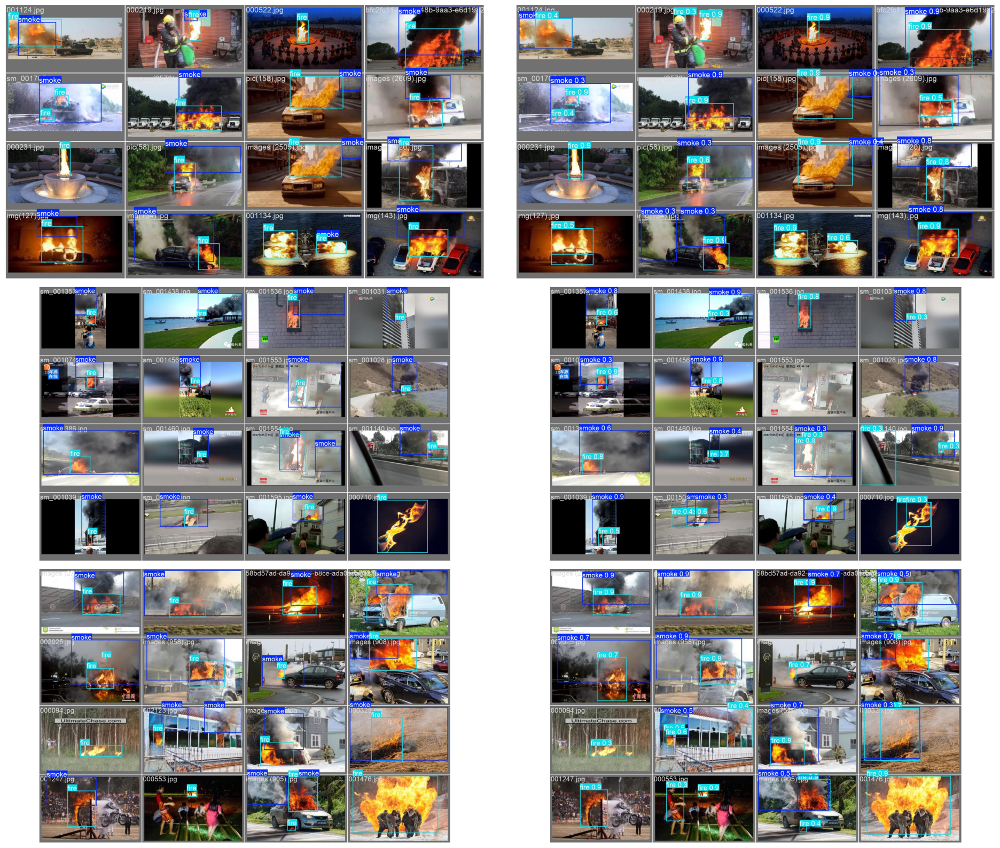

In [114]:
def visualize_validation(path):
    fig, axes = plt.subplots(3, 2, figsize=(20, 16))

    for i in range(3):
        for j, mode in enumerate(['labels', 'pred']):
            image_path = os.path.join(path, f'val_batch{i}_{mode}.jpg')
            axes[i, j].imshow(cv2.cvtColor(cv2.imread(image_path), cv2.COLOR_BGR2RGB))
            axes[i, j].axis('off')

    fig.tight_layout()
    plt.show()

path = 'runs/detect/train30' #best model
visualize_validation(path)

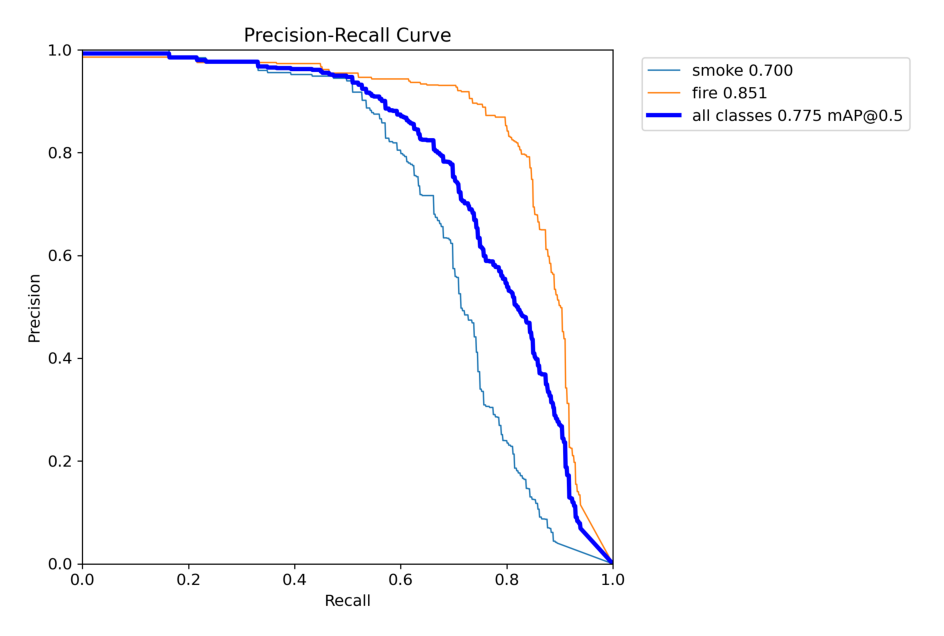

In [82]:
image_path = 'runs/detect/train30/PR_curve.png'
fig, axes = plt.subplots(figsize=(14,8))
axes.imshow(cv2.cvtColor(cv2.imread(image_path), cv2.COLOR_BGR2RGB))
axes.axis('off')
plt.show()

In [88]:
import PIL
PIL.Image.MAX_IMAGE_PIXELS = 933120000

path = r'datasets\smoke_fire_yolo_dataset\images'
paths = [os.path.join(path, 'val', name) for name in os.listdir(os.path.join(path, 'val'))]

model = YOLO("runs/detect/tune/weights/best.pt")

results_cuda = model.predict(paths, verbose=False, device='cuda:0')
print(f'''Cuda inference speed: {f"{[f'{key}: {value:.2f}' for key, value in results_cuda[0].speed.items()]}"}''')
results_cpu = model.predict(paths, verbose=False, device='cpu')
print(f'''Cpu inference speed: {f"{[f'{key}: {value:.2f}' for key, value in results_cpu[0].speed.items()]}"}''')

Cuda inference speed: ['preprocess: 3.09', 'inference: 2.28', 'postprocess: 0.49']
Cpu inference speed: ['preprocess: 2.78', 'inference: 2.21', 'postprocess: 0.58']


Вычисления проводились на RTX 4070 Super (12 Gb), Intel Core i5 13600kf